# Scripted vs Spontaneous Speech (5sec)

In this section, we explore the differences between scripted speech and casual/spontaneous speech. Both speaking styles feature minimal vocal variations yet impactful. It has been observed that speaking style could affect voice perception in humans in case of unfamiliar voices ([Smith et al. (2019)](https://onlinelibrary.wiley.com/doi/epdf/10.1002/acp.3478?saml_referrer), [Stevenage et al. (2021)](https://link.springer.com/content/pdf/10.1007/s10919-020-00348-w.pdf) and [Afshan et al. (2022)](https://asa.scitation.org/doi/pdf/10.1121/10.0009585?casa_token=rSyTJ-uiRW8AAAAA:GlyYCKNccGdLEfnk5oynoj-IgLnAlSBPuHTndx8uzg0VsupZ3bOFqfGJROBRhBxdcgs6ozZR0DvL)). Accordingly, we are going to investigate the effect of speaking style on generating speech embeddings that should maintain close distances with samples from the same speaker.

## Literature Review:

[Smith et al. (2019)](https://onlinelibrary.wiley.com/doi/epdf/10.1002/acp.3478?saml_referrer)
1) **Premise:**
In this paper, the authors studied the effect of changing speaking style and adding background noise on identifying voices for forensics applications. The approach adopted in this study is to make the participants listen to two recordings and report if both recordings are from the same speaker or diffferent with a self-rated confidence. The experiments included style-matched trials for read speech (scripted speech) and style-mismatched trials with read and spontaneous speech.

2) **Results:**
They observed that listeners acheived higher accuracy with confidence in case of style-matched trials compared to style-mismatched trials.

3) **Limitation:**
They didn't investigate if style-matched trials for spontaneous speech is better than the read/scripted one or not, to observe which speaking style is more robust for identity processing.

[Stevenage et al. (2021)](https://link.springer.com/content/pdf/10.1007/s10919-020-00348-w.pdf)
1) **Premise:** 
In this paper, they addressed the limitation in the previous work. They held the same experiment setup in addition to including a style-matched trials for spontaneous speech. Thus, the authors extended the understanding of which speaking style is more efficient in terms of speaker discrimination tasks.

2) **Results:** 
The results suggest that identity processing was impaired in style-mismatched trials compared to matched ones, confirming previous findings. Also, the performance of participants is better ehen listening to congruent read speech compared to congruent spontaneous speech.

3) **Limitation:** 
These experiments left an open question of what are the perceptual strategies adopted by the listners that engendered such discrepancies between subtle variation in speaking styles.

[Afshan et al. (2022)](https://asa.scitation.org/doi/pdf/10.1121/10.0009585?casa_token=rSyTJ-uiRW8AAAAA:GlyYCKNccGdLEfnk5oynoj-IgLnAlSBPuHTndx8uzg0VsupZ3bOFqfGJROBRhBxdcgs6ozZR0DvL)
1) **Premise:**
This paper takes a step further and explores the listners' perceptual strategies in case of telling people together vs telling people apart. The authors performed experiments similar to what have been mentioned above. However, they explored the acoustic spaces of speakers to study the impact of acoustic variability on perceptual strategies.

2) **Results:**
They confirmed the previous results concerning listners' performance when encountered with matched vs. mismacthed trials and the robustness of read speech compared to spontaneous. Moreover, they found that the 'hard' and 'easy' examples for telling people together weren't the same as telling people apart. Indicating that listners adopted different perceptual strategies in both cases. Accordingly, it has been suggested that when telling people together, listners relied on speaker-specific idiosyncrasies while when telling people apart it was decided based on the distances between speakers in the acoustic space. Consquently, one can argue that the difficulty of telling people apart might be easily predicted by studying the acoustic space compared to telling people together.

3) **Limitation/Future work:**
It might be worth exploring the neurological basis of the suggested perceptual strategies and how could it vary across listners, not just speakers because as per all pervious work, one might hypothesize that telling people apart is speaker-dependent (acoustic space of speakers) while telling people together is more listner-dependent (perceptual space of listners). That being said, it might be crucial to further probe in the listners' perception aspect.

### <span style="color:blue"><div style="text-align: justify">Research Questions:</div></span>
1) Is there a noticeable within-speaker difference between scripted and spontaneous speech utterances?
2) Would the difference change depending on the type of feature extrator used?
3) Is this difference maintained in lower dimensions?

## Dataset Description:

The dataset used in this experiment is obtained from [here](https://speechbox.linguistics.northwestern.edu/ALLSSTARcentral/#!/recordings). We compiled speech utterances from 26 speakers (14 females and 12 males). The collected dataset comprises 7 tasks (4 scripted/3 spontaneous).

Tasks:

1) NWS (script): Reading *'The North Wind and Sun'* passage
2) LPP (script): Reading *'The Little Prince'* scentences
3) DHR (script): Reading *'Declaration of Human Rights'* scentences
4) HT2 (script): Reading *'Hearing in Noise Test 2'* scentences
5) QNA (spon): Answering questions *'Q and A session'*
6) ST1 (spon): Telling a personal story 1
7) ST2 (spon): Telling a personal story 2

The dataset was processed by undersampling to 16 kHz to be compatible with BYOL-S models. Additionally, the utterances were cropped to fixed durations (1, 3, 5, 10, 15 sec) to yield 5 new datasets generated from the original one.

Finally, the naming convention for the audio files is: *{ID}_{Gender}_{Task}_{Label}_{File Number}.wav* (e.g. 049_F_DHR_script_000.wav).

In the following analysis, we will be using the 5sec-utterance version of the dataset.

## 1) Loading Data

In [ ]:
import matplotlib as mpl
from pylab import cm

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import deciphering_enigma
import matplotlib.pyplot as plt

#define the experiment config file path
path_to_config = './config.yaml'

#read the experiment config file
exp_config = deciphering_enigma.load_yaml_config(path_to_config)
dataset_path = exp_config.dataset_path

#register experiment directory and read wav files' paths
audio_files_orig = deciphering_enigma.build_experiment(exp_config)
print(f'Dataset has {len(audio_files_orig)} samples')

Dataset has 6471 samples


In [3]:
if exp_config.preprocess_data:
    dataset_path = deciphering_enigma.preprocess_audio_files(audio_files, speaker_ids=metadata_df['ID'], chunk_dur=exp_config.chunk_dur, resampling_rate=exp_config.resampling_rate, 
                    save_path=f'{exp_config.dataset_name}_{exp_config.model_name}/preprocessed_audios', audio_format=audio_format)
#balance data to have equal number of labels per speaker
audio_files = deciphering_enigma.balance_data('/om2/user/gelbanna/datasets/scripted_spont_dataset/preprocessed_audios_dur3sec/*')
print(f'After Balancing labels: Dataset has {len(audio_files)} samples')

#extract metadata from file name convention
metadata_df, audio_format = deciphering_enigma.extract_metadata(exp_config, audio_files)

#load audio files as torch tensors to get ready for feature extraction
audio_tensor_list = deciphering_enigma.load_dataset(audio_files, cfg=exp_config, speaker_ids=metadata_df['ID'], audio_format=audio_format)

After Balancing labels: Dataset has 5816 samples
Audio Tensors are already saved for scriptvsspon_speech


## 2) Generating Embeddings

We are generating speech embeddings from 9 different models (BYOL-A, BYOL-S/CNN, BYOL-S/CvT, Hybrid BYOL-S/CNN, Hybrid BYOL-S/CvT, Wav2Vec2, HuBERT and Data2Vec).

In [4]:
#generate speech embeddings
embeddings_dict = deciphering_enigma.extract_models(audio_tensor_list, exp_config)

Load BYOL-A_default Model
BYOL-A_default embeddings are already saved for scriptvsspon_speech
(5816, 2048)
Load BYOL-S_default Model
BYOL-S_default embeddings are already saved for scriptvsspon_speech
(5816, 2048)
Load Hybrid_BYOL-S_default Model
Hybrid_BYOL-S_default embeddings are already saved for scriptvsspon_speech
(5816, 2048)
Load BYOL-S_cvt Model
BYOL-S_cvt embeddings are already saved for scriptvsspon_speech
(5816, 2048)
Load Hybrid_BYOL-S_cvt Model
Hybrid_BYOL-S_cvt embeddings are already saved for scriptvsspon_speech
(5816, 2048)
Load TRILLsson Model
TRILLsson embeddings are already saved for scriptvsspon_speech
(5816, 1024)
Load Wav2Vec2 Model
Wav2Vec2 embeddings are already saved for scriptvsspon_speech
(5816, 1024)
Load HuBERT Model
HuBERT embeddings are already saved for scriptvsspon_speech
(5816, 1280)
Load Data2Vec Model
Data2Vec embeddings are already saved for scriptvsspon_speech
(5816, 1024)


## 3) Original Dimension Analysis

### 3.1. Distance-based

Compute distances (e.g. cosine distance) across embeddings of utterances. Steps to compute it:

1) Compute distances across all 5816 samples in a pairwise format (5816\*5816).
2) Convert pairwise form to long form i.e. two long columns [Sample1, Sample2, Distance], yielding a dataframe of 5816\*5816 long.
3) Remove rows with zero distances (i.e. distances between a sample and itself).
4) Keep only the distances between samples from the same speaker and the same label (e.g. Dist{speaker1_Label1_audio0 --> speaker1_Label1_audio1}), as shown in figure below.
5) Remove duplicates, i.e. distance between 0 --> 1 == 1 --> 0.
6) Standardize distances within each speaker to account for within speaker variability space.
7) Remove the distances above 99% percentile (outliers).
8) Plot violin plot for each model, split by the label to see how are these models encode both labels.

![distance](distance_orig_dimensions.png)

In [5]:
df_all = deciphering_enigma.compute_distances(metadata_df, embeddings_dict, exp_config.dataset_name, 'cosine', list(metadata_df.columns))

DF for the cosine distances using BYOL-A_default already exist!
DF for the cosine distances using BYOL-S_default already exist!
DF for the cosine distances using Hybrid_BYOL-S_default already exist!
DF for the cosine distances using BYOL-S_cvt already exist!
DF for the cosine distances using Hybrid_BYOL-S_cvt already exist!
DF for the cosine distances using TRILLsson already exist!
DF for the cosine distances using Wav2Vec2 already exist!
DF for the cosine distances using HuBERT already exist!
DF for the cosine distances using Data2Vec already exist!


In [25]:
import math
def cohend(d1, d2):
    # calculate the size of samples
    n1, n2 = len(d1), len(d2)
    # calculate the variance of the samples
    s1, s2 = np.var(d1, ddof=1), np.var(d2, ddof=1)
    # calculate the pooled standard deviation
    s = math.sqrt(((n1 - 1) * s1 + (n2 - 1) * s2) / (n1 + n2 - 2))
    # calculate the means of the samples
    u1, u2 = np.mean(d1), np.mean(d2)
    # calculate the effect size
    return (u1 - u2) / s
def visualize_violin_dist(df_all):
    fig, ax = plt.subplots(1, 1, figsize=(30, 15))
    violin = sns.violinplot(data=df_all, x='Model', y='Distance', inner='quartile', hue='Label_1', split=True, ax=ax)
    ax.set(xlabel=None, ylabel=None)
    ax.set_xticklabels(ax.get_xticklabels(), size = 20, rotation=45)
    ax.set_yticklabels(ax.get_yticks(), size = 20)
    ax.set_ylabel('Standardized Cosine Distances', fontsize=25)
    ax.set_xlabel('Models', fontsize=25)

    # statistical annotation
    y, h, col = df_all['Distance'].max() + df_all['Distance'].max()*0.05, df_all['Distance'].max()*0.01, 'k'
    for i, model_name in enumerate(df_all['Model'].unique()):
        d=cohend(df_all['Distance'].loc[(df_all.Label_1=='spon') & (df_all.Model==model_name)], df_all['Distance'].loc[(df_all.Label_1=='script') & (df_all.Model==model_name)])
        x1, x2 = -0.25+i, 0.25+i
        ax.plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1.5, c=col)
        ax.text((x1+x2)*.5, y+(h*1.5), f'cohen d={d:.2}', ha='center', va='bottom', color=col, fontsize=20)
    violin.legend(fontsize = 30, \
                   bbox_to_anchor= (1, 1), \
                   title="Labels", \
                   title_fontsize = 30, \
                   shadow = True, \
                   facecolor = 'white');
    plt.tight_layout()
    plt.savefig('violinplot.png')

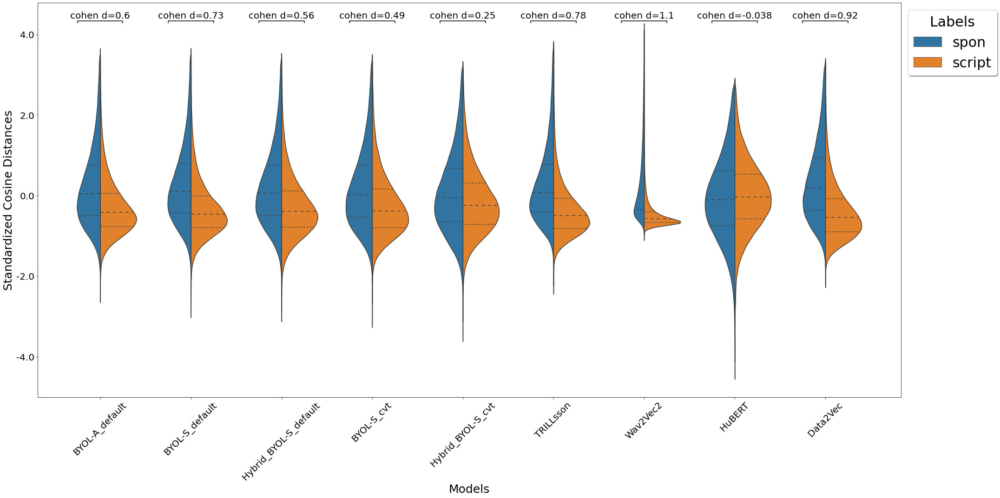

In [26]:
visualize_violin_dist(df_all)

### <span style="color:red"><div style="text-align: justify">Discussion:</div></span>

The above violin plot illustrates the cosine distance distribution within each speaker for both labels (Scripted and Spontaneous Speech). That being said, one can notice that for most models there is a high effect size between the distributions meaning that the models are able to encode scripted speech utterances closer from each other relative to spontaneous speech utterances. However, some models such as HuBERT and Hybrid BYOL-S/CvT show no or small effect size, respectively. Thus, both models have similar distance distribution for both labels across speakers.

The observed discrepancies could be engendered from the nature of those speaking styles. For instance, in conversational speech, it is expected to have more pauses and non-speech vocalizations which could affect the way the model encode/perceive such utterances.

We still can't tell if the distribution discrepancies are due to a shift in identity processing or maybe these models are not encoding identity, thus the distances wouldn't be an adequate proxy for identity perception.

Consequently, the next step comprises linear encoding which helps to evaluate the predictive power of these models in identifying speakers from scripted vs spontaneous utterances.

### 3.2. Linear Encoding:

In this section, we evaluate the self-supervised models ability to identify speakers from scripted vs spontaneous speech by leveraging different ML classifiers such as Logistic Regression (LR), Random Forest (RF) and Support Vector Machine (SVM). The work flow of this section, for each model, is as follows:
1) Split the data by labels to have two label-based datasets; one for scripted samples and the other for spontaneous
2) Split each label-based dataset into train and test sets (70% and 30%, respectively) (Note: the splitting here is done per speaker to maintain equal ratio of samples across speakers)
3) Build a pipeline that consists of standardizing the data then passing it to the classifier.
4) The pipeline is implemented with gridsearch training with CV (repeated stratified K-fold). Meaning that for each hyperparameter sequence (in this example total sequences = 22), a stratified 5-fold CV is implemented and repeated (in this example 3 times). Then compute unweighted average recall (UAR) for each training.
5) Consequently, the encoder yields several UAR scores for each classifier, each label and eventually each model. (illustrated in the violin plots below)
6) Lastly, the UAR on the unseen test set is reported in the cell below.

In [31]:
ml_encoder = deciphering_enigma.ML_Encoder()
for i, (model_name, embeddings) in enumerate(embeddings_dict.items()):
    ml_encoder.run(model_name, embeddings, metadata_df['Label'], metadata_df['ID'], exp_config.dataset_name)

Linear Encoding Scores are already saved for BYOL-A_default model!
Linear Encoding Scores are already saved for BYOL-S_default model!
Linear Encoding Scores are already saved for Hybrid_BYOL-S_default model!
Linear Encoding Scores are already saved for BYOL-S_cvt model!
Linear Encoding Scores are already saved for Hybrid_BYOL-S_cvt model!
Linear Encoding Scores are already saved for Wav2Vec2 model!
Linear Encoding Scores are already saved for HuBERT model!
Linear Encoding Scores are already saved for Data2Vec model!


In [5]:
df = pd.DataFrame({'Model': [], 'Label': [], 'Clf': [], 'Score': []})
for model_name in embeddings_dict.keys():
    df_model = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/linear_encoding_scores.csv')
    df_model = df_model[df_model.Score > np.percentile(df_model.Score,10)]
    df = pd.concat([df, df_model])

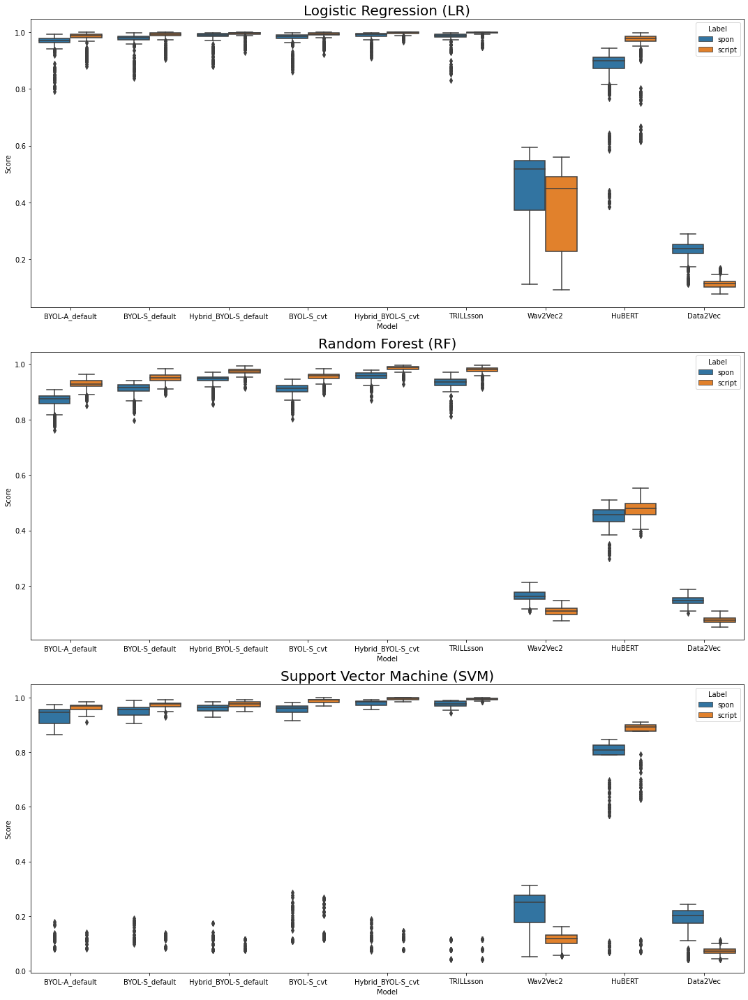

In [6]:
fig, ax = plt.subplots(3, 1, figsize=(15, 20))
ax = ax.flatten()
ax[0].set_title('Logistic Regression (LR)', fontsize=20)
sns.boxplot(data=df.loc[df.Clf == 'LR'], x='Model', y='Score', hue='Label', ax=ax[0])
ax[1].set_title('Random Forest (RF)', fontsize=20)
sns.boxplot(data=df.loc[df.Clf == 'RF'], x='Model', y='Score', hue='Label', ax=ax[1])
ax[2].set_title('Support Vector Machine (SVM)', fontsize=20)
sns.boxplot(data=df.loc[df.Clf == 'SVM'], x='Model', y='Score', hue='Label', ax=ax[2])
plt.tight_layout()
plt.savefig('linear_encoding.png')

Zoom in for some models by removing the *facebook* models for better visualization

In [25]:
df = df.loc[(df.Model != 'HuBERT') & (df.Model != 'Wav2Vec2') & (df.Model != 'Data2Vec')]

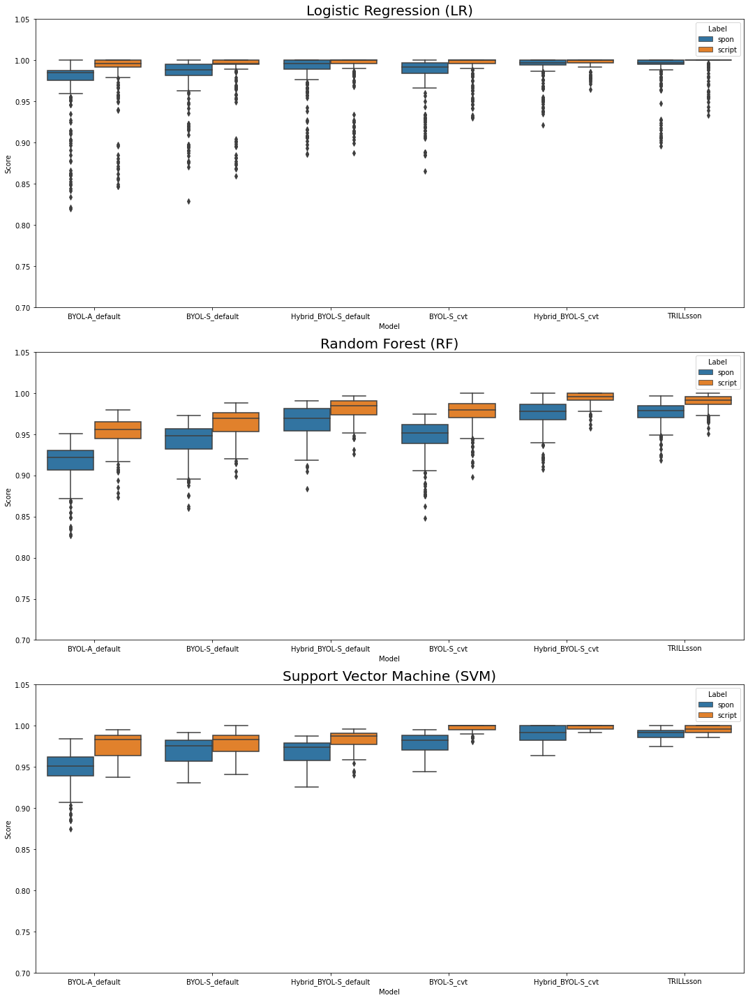

In [26]:
fig, ax = plt.subplots(3, 1, figsize=(15, 20))
ax = ax.flatten()
ax[0].set_title('Logistic Regression (LR)', fontsize=20)
ax[0].set_ylim([0.7,1.05])
sns.boxplot(data=df.loc[df.Clf == 'LR'], x='Model', y='Score', hue='Label', ax=ax[0])
ax[1].set_title('Random Forest (RF)', fontsize=20)
ax[1].set_ylim([0.7,1.05])
sns.boxplot(data=df.loc[df.Clf == 'RF'], x='Model', y='Score', hue='Label', ax=ax[1])
ax[2].set_title('Support Vector Machine (SVM)', fontsize=20)
ax[2].set_ylim([0.7,1.05])
sns.boxplot(data=df.loc[df.Clf == 'SVM'], x='Model', y='Score', hue='Label', ax=ax[2])
plt.tight_layout()

### 3.3. Similarity Representation Analysis:

Load openSMILE eGeMAPS feature set

In [30]:
embeddings_dict = deciphering_enigma.add_os_features(embeddings_dict, exp_config.dataset_name, audio_files_orig, audio_files)

FileNotFoundError: [Errno 2] No such file or directory: '../scriptvsspon_speech/os_egemaps_embeddings_script_spon_5sec.npy'

In [8]:
cka_class = deciphering_enigma.CKA(unbiased=True, kernel='rbf', rbf_threshold=0.5)
cka_ = deciphering_enigma.run_cka(cka_class, embeddings_dict)

  0%|                                                                                                                                          | 0/12 [00:00<?, ?it/s]

(12, 12)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [03:14<00:00, 16.24s/it]


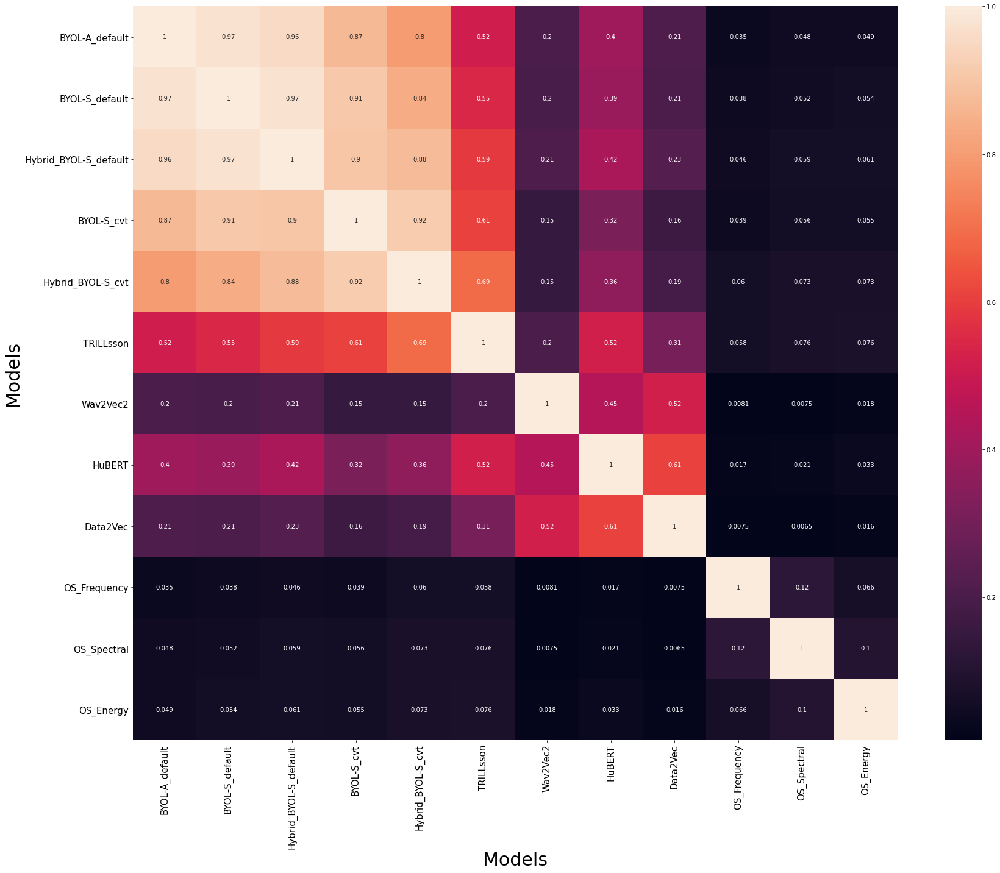

In [9]:
cka_class.plot_heatmap(cka_, embeddings_dict.keys(), save_path=f'{exp_config.dataset_name}', save_fig=True)

## 4) Dimensionality Reduction

The previous analysis showed how well the model is capable of grouping the uttereances of the same speaker in different cases (scripted and spontaneous) in the embedding space (high dimension). That being said, we will replicate the same analysis but in the lower dimension space to visualize the impact of speaking styles on voice identity perception.

Accordingly, we will utilize different kind of dimensionality reduction such as PCA, tSNE, UMAP and PaCMAP to get a better idea of how the speakers' samples are clustered together in 2D. However, one constraint is that these methods are sensitive to their hyperparameters (except PCA) which could imapct our interpretation of the results. Thus, a grid search across the hyperparameters for each method is implemented.

Another issue would be quantifying the ability of these methods to perserve the distances amongst samples in the high dimension and present it in a lower dimension. To address this, we are using two metrics KNN and CPD that represent the ability of the algorithm to preserve local and global structures of the original embedding space, respectively. Both metrics are adopted from this [paper](https://www.nature.com/articles/s41467-019-13056-x) in which they define both metrics as follows:

* KNN: The fraction of k-nearest neighbours in the original high-dimensional data that are preserved as k-nearest neighbours in the embedding. KNN quantifies preservation of the local, or microscopic structure. The value of K used here is the min number of samples a speaker would have in the original space.

* CPD: Spearman correlation between pairwise distances in the high-dimensional space and in the embedding. CPD quantifies preservation of the global, or macroscropic structure. Computed across all pairs among 1000 randomly chosen points with replacement. 

Consequently, we present the results from dimensionality reduction methods in two ways, one optimimizing local structure metric (KNN) and the other optimizing global structure metric (CPD).

### <a id='another_cell'></a> 4.1 Mapping Labels

In [6]:
tuner = deciphering_enigma.ReducerTuner()
for i, model_name in enumerate(embeddings_dict.keys()):
    print(f'{model_name}:')
    tuner.tune_reducer(embeddings_dict[model_name], metadata=metadata_df, dataset_name=exp_config.dataset_name, model_name=model_name)

BYOL-A_default:
Tuned Reduced Embeddings already saved for BYOL-A_default model!
BYOL-S_default:
Tuned Reduced Embeddings already saved for BYOL-S_default model!
Hybrid_BYOL-S_default:
Tuned Reduced Embeddings already saved for Hybrid_BYOL-S_default model!
BYOL-S_cvt:
Tuned Reduced Embeddings already saved for BYOL-S_cvt model!
Hybrid_BYOL-S_cvt:
Tuned Reduced Embeddings already saved for Hybrid_BYOL-S_cvt model!
TRILLsson:
Tuned Reduced Embeddings already saved for TRILLsson model!
Wav2Vec2:
Tuned Reduced Embeddings already saved for Wav2Vec2 model!
HuBERT:
Tuned Reduced Embeddings already saved for HuBERT model!
Data2Vec:
Tuned Reduced Embeddings already saved for Data2Vec model!


#### 4.1.1. Mapping Gender

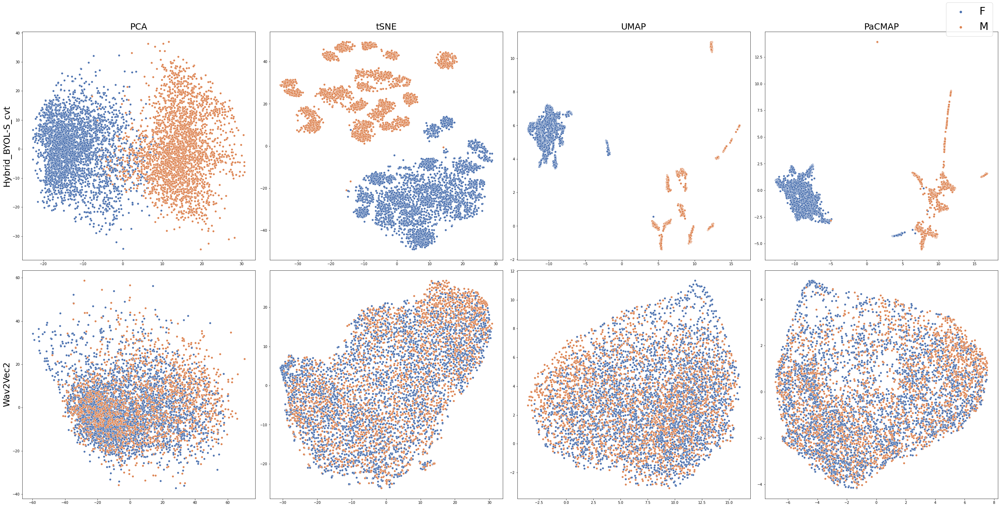

In [ ]:
fig, ax = plt.subplots(9, 4, figsize=(40, 90))
optimize = 'Global'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(embeddings_dict.keys()):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=25)
        deciphering_enigma.visualize_embeddings(df, 'Gender', metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=25)
ax[0,j].legend(bbox_to_anchor=(1, 1.15), fontsize=20)
plt.tight_layout()

#### 4.1.2. Mapping Identity

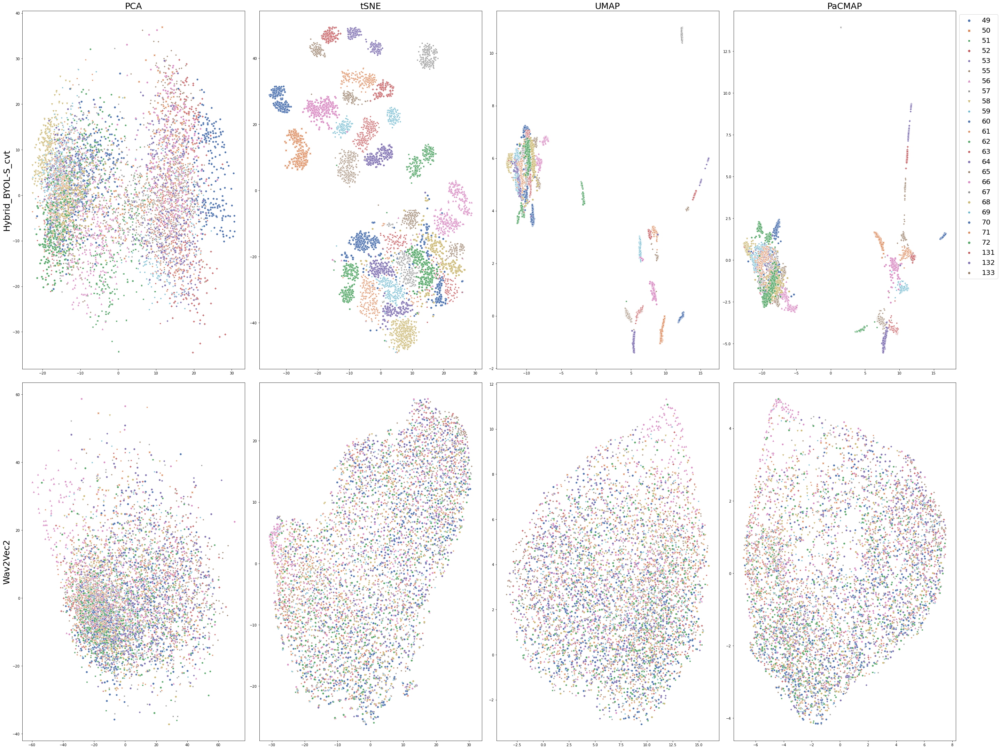

In [40]:
fig, ax = plt.subplots(2, 4, figsize=(40, 30))
optimize = 'Global'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(['Hybrid_BYOL-S_cvt', 'Wav2Vec2']):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=25)
        deciphering_enigma.visualize_embeddings(df, 'ID', metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=25)
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=20)
# handles, labels = ax[0,3].get_legend_handles_labels()
# fig.legend(handles, labels, loc='upper center')
plt.tight_layout()
plt.savefig('dim_red_id.png')

#### 4.1.3. Mapping Speaking Style (Script/Spon)

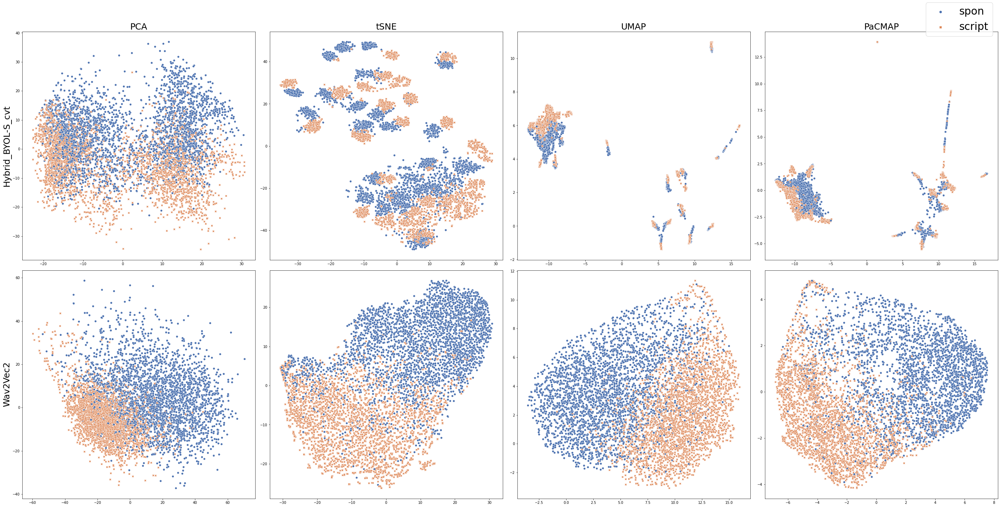

In [ ]:
fig, ax = plt.subplots(9, 4, figsize=(40, 90))
optimize = 'Global'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(embeddings_dict.keys()):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=25)
        deciphering_enigma.visualize_embeddings(df, 'Label', metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=25)
ax[0,j].legend(bbox_to_anchor=(1, 1.15), fontsize=20)
plt.tight_layout()

### 4.2 Mapping Acoustic Features

#### 4.2.1. Fundamental Frequency

In [11]:
f0s = deciphering_enigma.compute_acoustic_features(audio_files, save_path=f'../{exp_config.dataset_name}', feature='f0')

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3442/3442 [10:00<00:00,  5.73it/s]


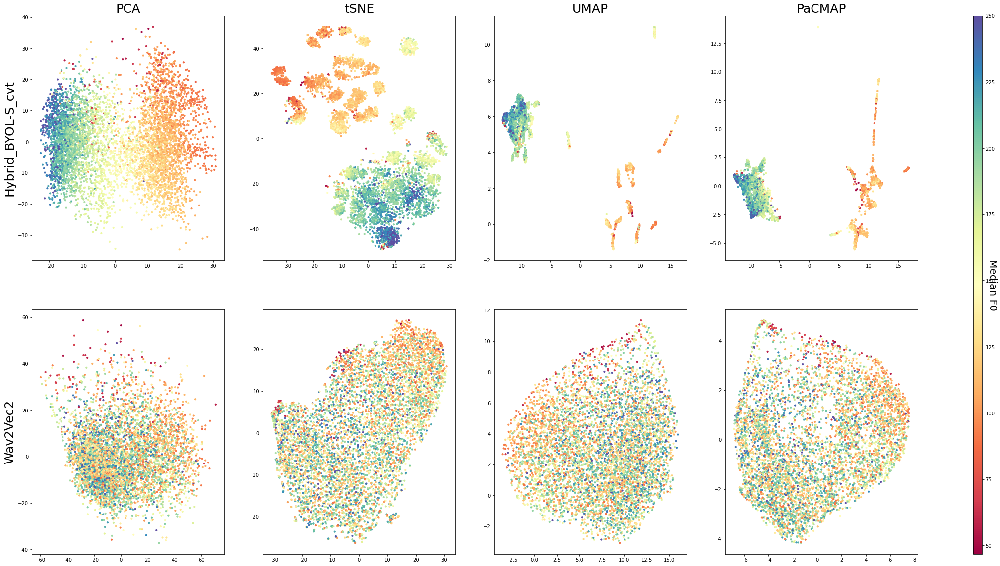

In [ ]:
fig, ax = plt.subplots(9, 4, figsize=(40, 90))
optimize = 'Global'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(embeddings_dict.keys()):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    df['f0'] = f0s
    df['f0'] = df['f0'].apply(lambda x: 250 if x > 250 else x)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=25)
        points = deciphering_enigma.visualize_embeddings(df, 'f0', metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='colorbar')
    ax[i, 0].set_ylabel(model_name, fontsize=25)
cbar = fig.colorbar(points, ax=ax, aspect=60)
cbar.ax.set_ylabel('Median F0', rotation=270, fontsize=20)
plt.show()

#### 4.2.2. RMS

In [13]:
rms = deciphering_enigma.compute_acoustic_features(audio_files, save_path=f'../{exp_config.dataset_name}', feature='rms')

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3442/3442 [08:02<00:00,  7.14it/s]


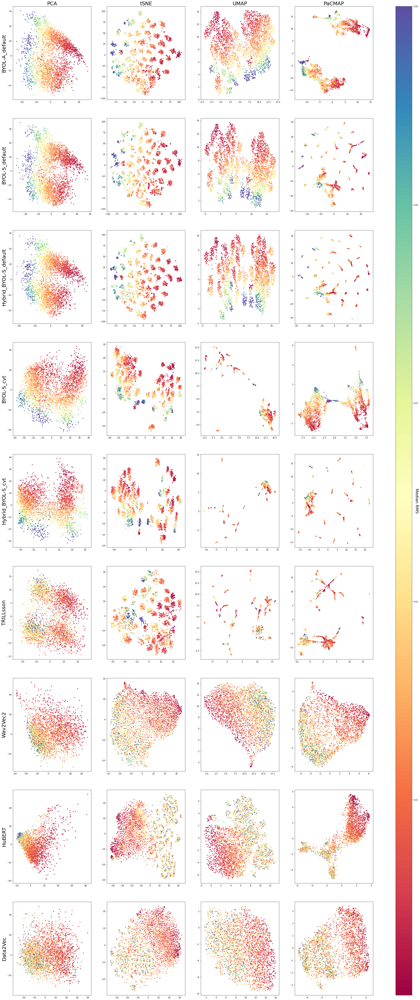

In [14]:
fig, ax = plt.subplots(9, 4, figsize=(40, 90))
optimize = 'Global'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(embeddings_dict.keys()):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    df['rms'] = rms
    df['rms'] = df['rms'].apply(lambda x: 0.05 if x > 0.05 else x)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=25)
        points = deciphering_enigma.visualize_embeddings(df, 'rms', metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='colorbar')
    ax[i, 0].set_ylabel(model_name, fontsize=25)
cbar = fig.colorbar(points, ax=ax, aspect=60)
cbar.ax.set_ylabel('Median RMS', rotation=270, fontsize=20)
plt.show()

#### 4.2.3. First MFCC

In [15]:
mfcc_start = deciphering_enigma.compute_acoustic_features(audio_files, save_path=f'../{exp_config.dataset_name}', feature='mfcc', mfcc_num=1)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3442/3442 [12:21<00:00,  4.64it/s]


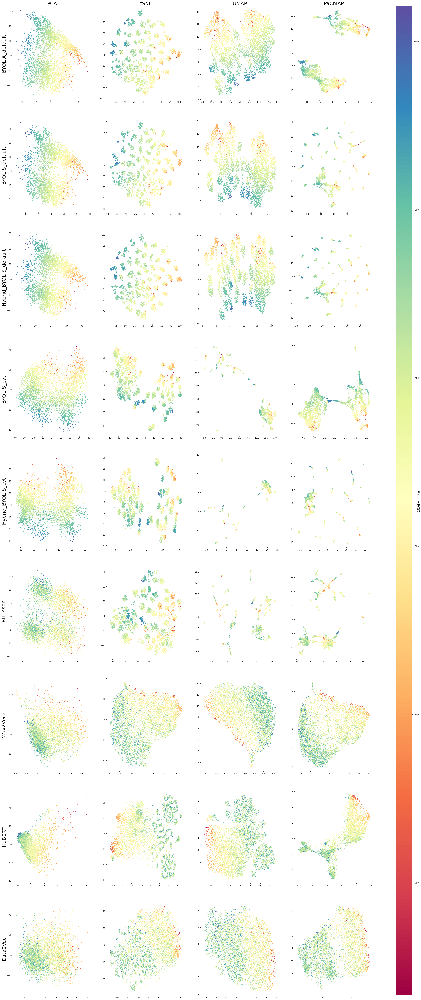

In [16]:
fig, ax = plt.subplots(9, 4, figsize=(40, 90))
optimize = 'Global'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(embeddings_dict.keys()):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    df['mfcc'] = mfcc_start
    # df['rms'] = df['rms'].apply(lambda x: 0.05 if x > 0.05 else x)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=25)
        points = deciphering_enigma.visualize_embeddings(df, 'mfcc', metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='colorbar')
    ax[i, 0].set_ylabel(model_name, fontsize=25)
cbar = fig.colorbar(points, ax=ax, aspect=60)
cbar.ax.set_ylabel('First MFCC', rotation=270, fontsize=20)
plt.show()

#### 4.2.4. Number of Syllables

In [17]:
num_syl = deciphering_enigma.compute_acoustic_features(audio_files, save_path=f'../{exp_config.dataset_name}', feature='num_syl')

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3442/3442 [13:12<00:00,  4.34it/s]


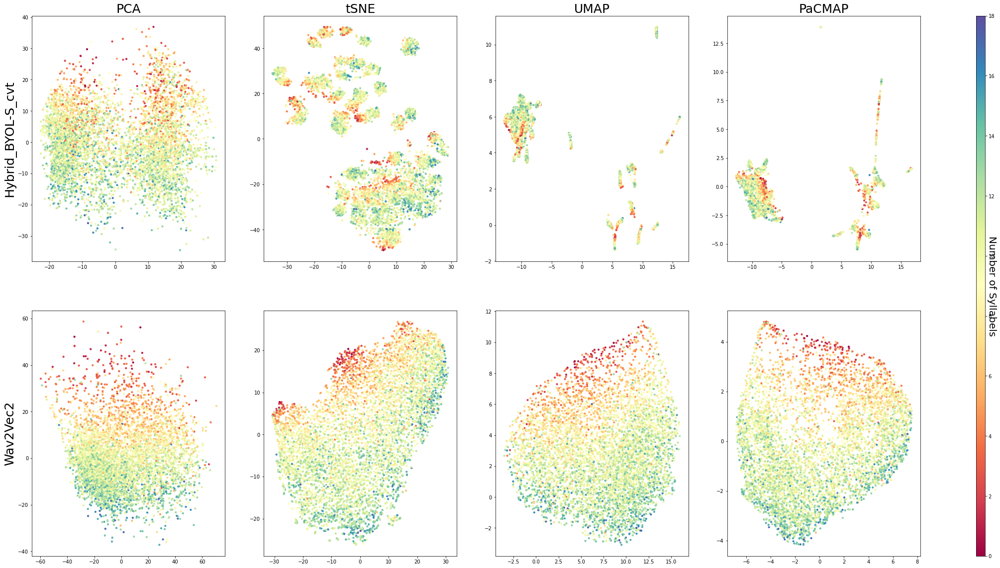

In [ ]:
fig, ax = plt.subplots(9, 4, figsize=(40, 90))
optimize = 'Global'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(embeddings_dict.keys()):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    df['num_syl'] = num_syl
    # df['rms'] = df['rms'].apply(lambda x: 0.05 if x > 0.05 else x)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=25)
        points = deciphering_enigma.visualize_embeddings(df, 'num_syl', metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='colorbar')
    ax[i, 0].set_ylabel(model_name, fontsize=25)
cbar = fig.colorbar(points, ax=ax, aspect=60)
cbar.ax.set_ylabel('Number of Syllabels', rotation=270, fontsize=20)
plt.show()